# Demo: Anime Face Generation and Super-Resolution

This notebook demonsmtrates key experiments from our project on resource-efficient generation of synthetic anime faces using DCGAN, WGAN-GP, and custom-trained ESRGAN models. All models were trained and evaluated using PyTorch on a MacBook Pro with an M2 Pro chip.

The pipeline consists of two stages:
1. **Image Generation** (64×64) using DCGAN and WGAN-GP
2. **Super-Resolution** (up to 256×256) using ESRGAN-based architectures


## Setup

We begin by importing libraries and 


In [1]:
# =======================
# 📦 Import Dependencies
# =======================
import os
import random
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
from torchvision.transforms.functional import to_tensor, to_pil_image, rgb_to_grayscale
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
from IPython.display import HTML
import kagglehub 
import json
import glob
from torch.utils.data import DataLoader, Dataset
from PIL import Image
import torchvision

## Device Selection
Let's set up the compute device. The notebook is compatible with CPU, GPU, or Apple's MPS backend.

In [2]:
# ========================
# 🔍 Device Selection
# ========================
# Automatically choose GPU (CUDA), MPS, or CPU based on availability

def get_device():
    if torch.cuda.is_available():
        return torch.device("cuda")
    elif torch.backends.mps.is_available():
        return torch.device("mps")
    else:
        return torch.device("cpu")

device = get_device()
print("Using device:", device)


Using device: mps


## Fixed Latent Vector Generator

This helper generates a batch of fixed latent vectors sampled from a standard normal distribution. A random seed can be specified to ensure reproducibility across runs.

These latent vectors are used to consistently test generator outputs across different epochs and models.


In [3]:
def get_fixed_latents(count, seed=None):
    if seed is not None:
        torch.manual_seed(seed)  # Set the seed for reproducibility
    fixed_latent = torch.randn(count, 100, 1, 1, device=device)
    return fixed_latent

## Image Grid Conversion

This utility converts a batch of generated images into a NumPy array arranged in a grid format. The output is suitable for displaying using `matplotlib`.

It uses PyTorch’s `make_grid()` utility and transposes the tensor for correct visualization.


In [4]:
def to_grid_np(images):
    grid = torchvision.utils.make_grid(images.cpu(), nrow=3)
    return grid.numpy().transpose((1, 2, 0))

## Generator Architecture

Here we define the generator model architecture used by both DCGAN and WGAN-GP. This network transforms a latent vector of shape (100, 1, 1) into a 64×64 RGB image.

The output is scaled to the range [-1, 1] using a Tanh activation, which is later normalized back to [0, 1] for visualization.


In [5]:
# =========================================
# 🧠 Generator Network for DCGAN & WGAN-GP
# =========================================
# Generates 64×64 color images from 100-dimensional noise vectors

class ImageGenerator(nn.Module):
    def __init__(self, latent_size=100, img_channels=3):
        super(ImageGenerator, self).__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(latent_size, 64 * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(64 * 8),
            nn.ReLU(True),

            nn.ConvTranspose2d(64 * 8, 64 * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 4),
            nn.ReLU(True),

            nn.ConvTranspose2d(64 * 4, 64 * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 2),
            nn.ReLU(True),

            nn.ConvTranspose2d(64 * 2, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),

            nn.ConvTranspose2d(64, img_channels, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)


## Super-Resolution Helper (ESRGAN)

To enhance the visual quality of low-resolution generated images, we apply our custom-trained ESRGAN\_V2 4× model. This model uses RRDB blocks and pixel unshuffle operations to upscale 64×64 images to 256×256 resolution.


In [6]:
# ===================================
# 🧠 ESRGAN Generator (Super-Resolution)
# ===================================
# Upscales low-resolution images to higher resolution using RRDB blocks

class ESRGANGenerator(nn.Module):
    def __init__(self, num_in_ch=3, num_out_ch=3, scale=2, num_feat=64, num_block=6, num_grow_ch=32):
        super(ESRGANGenerator, self).__init__()
        self.scale = scale
        if scale == 2:
            num_in_ch = num_in_ch * 4
        elif scale == 1:
            num_in_ch = num_in_ch * 16

        self.conv_first = nn.Conv2d(num_in_ch, num_feat, 3, 1, 1)
        self.body = nn.Sequential(*[RRDB(num_feat) for _ in range(num_block)])
        self.conv_body = nn.Conv2d(num_feat, num_feat, 3, 1, 1)

        self.conv_up1 = nn.Conv2d(num_feat, num_feat, 3, 1, 1)
        self.conv_up2 = nn.Conv2d(num_feat, num_feat, 3, 1, 1)
        self.conv_hr = nn.Conv2d(num_feat, num_feat, 3, 1, 1)
        self.conv_last = nn.Conv2d(num_feat, num_out_ch, 3, 1, 1)

        self.lrelu = nn.LeakyReLU(negative_slope=0.2, inplace=True)

    def forward(self, x):
        if self.scale == 2:
            feat = pixel_unshuffle(x, scale=2)
        elif self.scale == 1:
            feat = pixel_unshuffle(x, scale=4)
        else:
            feat = x

        feat = self.conv_first(feat)
        body_feat = self.conv_body(self.body(feat))
        feat = feat + body_feat

        feat = self.lrelu(self.conv_up1(F.interpolate(feat, scale_factor=2, mode='nearest')))
        feat = self.lrelu(self.conv_up2(F.interpolate(feat, scale_factor=2, mode='nearest')))
        out = self.conv_last(self.lrelu(self.conv_hr(feat)))
        return out

# =========================
# Utility: Pixel Unshuffle
# =========================
# Rearranges input tensor dimensions to prepare it for ESRGAN downsampling.

def pixel_unshuffle(x, scale):
    b, c, hh, hw = x.size()
    out_channel = c * (scale**2)
    assert hh % scale == 0 and hw % scale == 0
    h = hh // scale
    w = hw // scale
    x_view = x.view(b, c, h, scale, w, scale)
    return x_view.permute(0, 1, 3, 5, 2, 4).reshape(b, out_channel, h, w)


# =========================================
# Residual-in-Residual Dense Block (RRDB)
# =========================================
# Basic building block of ESRGAN's generator
# Provides deep feature reuse and stable training

class ResidualDenseBlock(nn.Module):
    def __init__(self, channels=64, growth_channels=32):
        super(ResidualDenseBlock, self).__init__()
        self.conv1 = nn.Conv2d(channels, growth_channels, kernel_size=3, stride=1, padding=1)
        self.conv2 = nn.Conv2d(channels + growth_channels, growth_channels, kernel_size=3, stride=1, padding=1)
        self.conv3 = nn.Conv2d(channels + 2 * growth_channels, growth_channels, kernel_size=3, stride=1, padding=1)
        self.conv4 = nn.Conv2d(channels + 3 * growth_channels, growth_channels, kernel_size=3, stride=1, padding=1)
        self.conv5 = nn.Conv2d(channels + 4 * growth_channels, channels, kernel_size=3, stride=1, padding=1)
        self.lrelu = nn.LeakyReLU(negative_slope=0.2, inplace=True)
        self.beta = 0.2

    def forward(self, x):
        x1 = self.lrelu(self.conv1(x))
        x2 = self.lrelu(self.conv2(torch.cat((x, x1), 1)))
        x3 = self.lrelu(self.conv3(torch.cat((x, x1, x2), 1)))
        x4 = self.lrelu(self.conv4(torch.cat((x, x1, x2, x3), 1)))
        x5 = self.conv5(torch.cat((x, x1, x2, x3, x4), 1))
        return x5 * self.beta + x

class RRDB(nn.Module):
    def __init__(self, channels=64):
        super(RRDB, self).__init__()
        self.rdb1 = ResidualDenseBlock(channels)
        self.rdb2 = ResidualDenseBlock(channels)
        self.rdb3 = ResidualDenseBlock(channels)
        self.beta = 0.2

    def forward(self, x):
        out = self.rdb1(x)
        out = self.rdb2(out)
        out = self.rdb3(out)
        return out * self.beta + x


## Dataset Identifiers

We specify the dataset names used to load pre-trained model weights:

- `soumikrakshit_anime-faces` (40k images)
- `ziggykor_anime-face-dataset-expanded-2024` (135k images)


In [7]:
dataset_name_40k = "soumikrakshit_anime-faces"
dataset_name_135k = "ziggykor_anime-face-dataset-expanded-2024"

## Loading Pretrained Models

In this section, we load all pretrained models used in the experiments/ablation study.

We use four image generators trained on 64×64 resolution:
- **DCGAN (40k dataset)** – final checkpoint
- **DCGAN (135k dataset)** – checkpoint from epoch 30 (best qualitative results)
- **WGAN-GP (40k dataset)** – final checkpoint
- **WGAN-GP (135k dataset)** – final checkpoint

For super-resolution, we load four models trained to upscale low-resolution images:
- **ESRGAN\_V1 2×** – trained on synthetic downscaled inputs
- **ESRGAN\_V1 4×** – trained on synthetic downscaled inputs
- **ESRGAN\_V2 4×** – trained on original low-resolution images (preferred model)
- **Real-ESRGAN Anime 4×** – pretrained baseline for comparison

All models are loaded to the appropriate device (GPU, MPS, or CPU) using PyTorch's dynamic device selection.


In [8]:
checkpoint = torch.load(f'dcgan/models/{dataset_name_40k}/model_checkpoint_latest.pth', map_location=device)
dcgan_generator_40k = ImageGenerator().to(device)
dcgan_generator_40k.load_state_dict(checkpoint['generator_state_dict'])
dcgan_generator_40k.eval()

checkpoint = torch.load(f'dcgan/models/{dataset_name_135k}/generator_checkpoint_epoch_30.pth', map_location=device)
dcgan_generator_135k = ImageGenerator().to(device)
dcgan_generator_135k.load_state_dict(checkpoint['generator_state_dict'])
dcgan_generator_135k.eval()

checkpoint = torch.load(f'wgan-gp/models/{dataset_name_40k}/model_checkpoint_latest.pth', map_location=device)
wgan_gp_generator_40k = ImageGenerator().to(device)
wgan_gp_generator_40k.load_state_dict(checkpoint['generator_state_dict'])
wgan_gp_generator_40k.eval()

checkpoint = torch.load(f'wgan-gp/models/{dataset_name_135k}/model_checkpoint_latest.pth', map_location=device)
wgan_gp_generator_135k = ImageGenerator().to(device)
wgan_gp_generator_135k.load_state_dict(checkpoint['generator_state_dict'])
wgan_gp_generator_135k.eval()

print("Iamge generator models are loaded")

Iamge generator models are loaded


In [9]:
checkpoint = torch.load(f'esrgan_imitation_v1/models/final_generator_{2}x.pth', map_location=device)
esrgan_v1_2x = ESRGANGenerator().to(device)
esrgan_v1_2x.load_state_dict(checkpoint['generator_state_dict'])
esrgan_v1_2x.eval()

checkpoint = torch.load(f'esrgan_imitation_v1/models/final_generator_{4}x.pth', map_location=device)
esrgan_v1_4x = ESRGANGenerator(scale=4).to(device)
esrgan_v1_4x.load_state_dict(checkpoint['generator_state_dict'])
esrgan_v1_4x.eval()

checkpoint = torch.load(f'esrgan_imitation_v2/models/final_generator_{4}x.pth', map_location=device)
esrgan_v2_4x = ESRGANGenerator(scale=4).to(device)
esrgan_v2_4x.load_state_dict(checkpoint['generator_state_dict'])
esrgan_v2_4x.eval()

checkpoint = torch.load(f'Real-ESRGAN/weights/RealESRGAN_x4plus_anime_6B.pth', map_location=device)
real_esrgan_anime_4x = ESRGANGenerator(scale=4).to(device)
if 'params_ema' in checkpoint:
    real_esrgan_anime_4x.load_state_dict(checkpoint["params_ema"], strict=True)
else:
    real_esrgan_anime_4x.load_state_dict(checkpoint, strict=True)
real_esrgan_anime_4x.eval()
print("ESRGAN models are loaded")

ESRGAN models are loaded


## Visualization Function

This function loads a generator checkpoint at a specific epoch, generates 4 images from fixed latent vectors, and optionally applies super-resolution.

Images are shown in a 2×2 grid representing the selected epochs.


In [10]:
def visualize_gan_progression(model_name: str, dataset_name: str, dataset_size:str, latents, save=True, epoch_numbers = [10,30,50,100]):
    latents = latents[:3]
    models = []
    fig, axs = plt.subplots(2, 2, figsize=(14, 6))
    for i, epoch_num in enumerate(epoch_numbers):
        checkpoint = torch.load(f'{model_name.lower()}/models/{dataset_name}/generator_checkpoint_epoch_{epoch_num}.pth', map_location=device)
        img_generator = ImageGenerator().to(device)
        img_generator.load_state_dict(checkpoint['generator_state_dict'])
        img_generator.eval()
        with torch.no_grad():
            fake_images = img_generator(latents)
            normalized_images = (fake_images + 1) / 2  # Scale from [-1, 1] to [0, 1]  
            clamped_images = torch.clamp(normalized_images, 0, 1)
            # enhanced_real_esrgan = torch.clamp(real_esrgan_anime_4x(clamped_images), 0, 1)
        img = to_grid_np(normalized_images)
        # enhanced_img_real = to_np_grid(enhanced_real_esrgan)
        axs[i//2][i%2].imshow(img)
        axs[i//2][i%2].set_title(f"Generated Images from epoch {epoch_num}", fontsize=24)
    
    for ax in axs.flat:
        ax.axis("off")
        


    title = f"{model_name.upper()} with sample size {dataset_size}"

    # Add title temporarily, remove before saving
    fig.suptitle(title, fontsize=15)
    plt.tight_layout()
    
    if save:
        # Temporarily remove the title for saving
        fig.canvas.draw()  # Required to finalize the layout
        fig.suptitle("")   # Remove title
        plt.savefig(f"experiment_images/{model_name.lower()}-{dataset_size}-different-epochs.png", dpi=72)
        fig.suptitle(title, fontsize=24)  # Add title back for display

    plt.show()

## Experiment 1: Comparing Generator Performance Over Epochs

Below, we set fixed latent vectors to generate 4 images (seed = 0) we visualize progression for each model trained on different dataset sizes. Each run displays four 64×64 synthetic anime faces generated at epochs 10, 30, 50, and 100.

In [11]:
img_cnt_to_show = 6
latents = get_fixed_latents(img_cnt_to_show, seed=0)

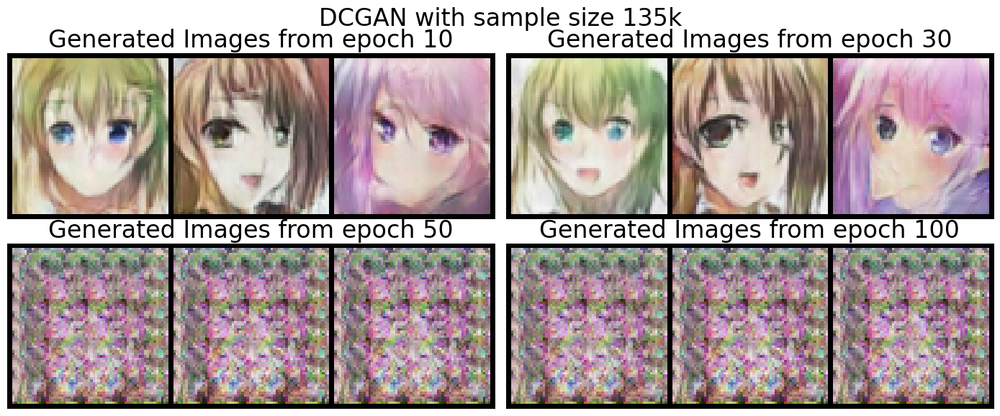

In [12]:
visualize_gan_progression("dcgan", dataset_name_135k, "135k", latents)

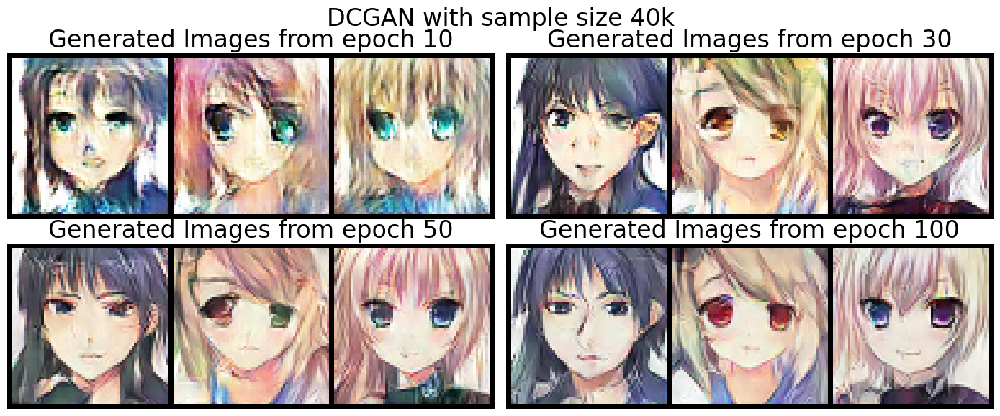

In [13]:
visualize_gan_progression("dcgan", dataset_name_40k, "40k", latents)

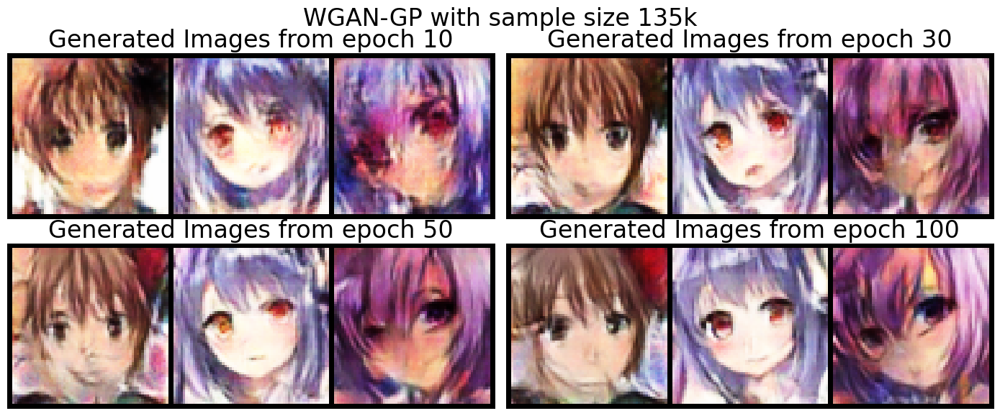

In [14]:
visualize_gan_progression("wgan-gp", dataset_name_135k, "135k", latents)

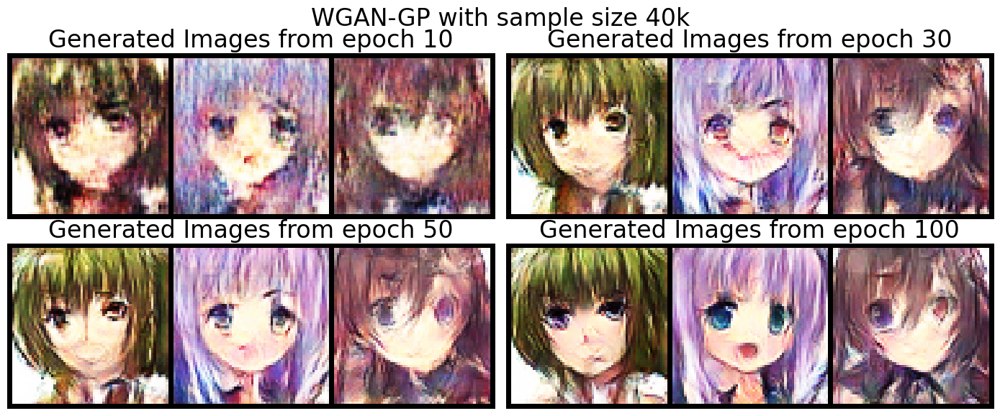

In [15]:
visualize_gan_progression("wgan-gp", dataset_name_40k, "40k", latents)

## Generator Loss Visualization

To better understand the training dynamics of our GAN models, we visualize the loss curves for both the generator and discriminator (or critic) across training iterations.

This function loads the saved loss logs from each of the four experiments:

- **DCGAN (40k samples)**
- **DCGAN (135k samples)**
- **WGAN-GP (40k samples)**
- **WGAN-GP (135k samples)**

Each subplot displays the generator loss and discriminator (or critic) loss. These plots help us assess training stability, convergence behavior, and signs of issues like vanishing gradients or mode collapse.


In [16]:
def visualize_image_generator_training_losses():
    # Create a 2x2 subplot figure
    fig, axs = plt.subplots(2, 2, figsize=(12, 8))
    
    
    # ------------------------
    # DCGAN with 40k samples
    # ------------------------
    loss_file = f"dcgan/models/{dataset_name_40k}/losses_final.json"
    with open(loss_file, "r") as f:
        loss_data = json.load(f)
    G_losses = loss_data["G_losses"]
    D_losses = loss_data["D_losses"]
    
    axs[0, 0].plot(G_losses, label="Generator")
    axs[0, 0].plot(D_losses, label="Discriminator")
    axs[0, 0].set_title("DCGAN (40k Samples)", fontsize=18)
    axs[0, 0].set_xlabel("Iterations", fontsize=14)
    axs[0, 0].set_ylabel("Loss", fontsize=14)
    axs[0, 0].legend(fontsize=12)
    
    # -------------------------
    # DCGAN with 135k samples
    # -------------------------
    loss_file = f"dcgan/models/{dataset_name_135k}/losses_final.json"
    with open(loss_file, "r") as f:
        loss_data = json.load(f)
    G_losses = loss_data["G_losses"]
    D_losses = loss_data["D_losses"]
    
    axs[0, 1].plot(G_losses, label="Generator")
    axs[0, 1].plot(D_losses, label="Discriminator")
    axs[0, 1].set_title("DCGAN (135k Samples)", fontsize=18)
    axs[0, 1].set_xlabel("Iterations", fontsize=14)
    axs[0, 1].set_ylabel("Loss", fontsize=14)
    axs[0, 1].legend(fontsize=12)
    
    # --------------------------
    # WGAN-GP with 40k samples
    # --------------------------
    loss_file = f"wgan-gp/models/{dataset_name_40k}/losses_final.json"
    with open(loss_file, "r") as f:
        loss_data = json.load(f)
    G_losses = loss_data["G_losses"]
    C_losses = loss_data["C_losses"]
    
    iterations_critic = np.arange(len(C_losses) - 15)
    gen_indices = [i for i, loss in enumerate(G_losses[15:]) if loss is not None]
    gen_losses = [loss for loss in G_losses[15:] if loss is not None]
    
    axs[1, 0].plot(iterations_critic, C_losses[15:], label="Critic")
    axs[1, 0].plot(gen_indices, gen_losses, label="Generator")
    axs[1, 0].set_title("WGAN-GP (40k Samples)", fontsize=18)
    axs[1, 0].set_xlabel("Iterations", fontsize=14)
    axs[1, 0].set_ylabel("Loss", fontsize=14)
    axs[1, 0].legend(fontsize=12)
    
    # ---------------------------
    # WGAN-GP with 135k samples
    # ---------------------------
    loss_file = f"wgan-gp/models/{dataset_name_135k}/losses_final.json"
    with open(loss_file, "r") as f:
        loss_data = json.load(f)
    G_losses = loss_data["G_losses"]
    C_losses = loss_data["C_losses"]
    
    iterations_critic = np.arange(len(C_losses) - 15)
    gen_indices = [i for i, loss in enumerate(G_losses[15:]) if loss is not None]
    gen_losses = [loss for loss in G_losses[15:] if loss is not None]
    
    axs[1, 1].plot(iterations_critic, C_losses[15:], label="Critic")
    axs[1, 1].plot(gen_indices, gen_losses, label="Generator")
    axs[1, 1].set_title("WGAN-GP (135k Samples)", fontsize=18)
    axs[1, 1].set_xlabel("Iterations", fontsize=14)
    axs[1, 1].set_ylabel("Loss", fontsize=14)
    axs[1, 1].legend(fontsize=12)
    
    # Adjust layout
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for suptitle
    
    # Save the plot
    plt.savefig("experiment_images/loss_comparison_plot.png", dpi=72)
    
    
    # Add a main title
    fig.suptitle("Training Losses: DCGAN vs. WGAN-GP on Varying Dataset Sizes", fontsize=20)
    
    # Show the plot
    plt.show()

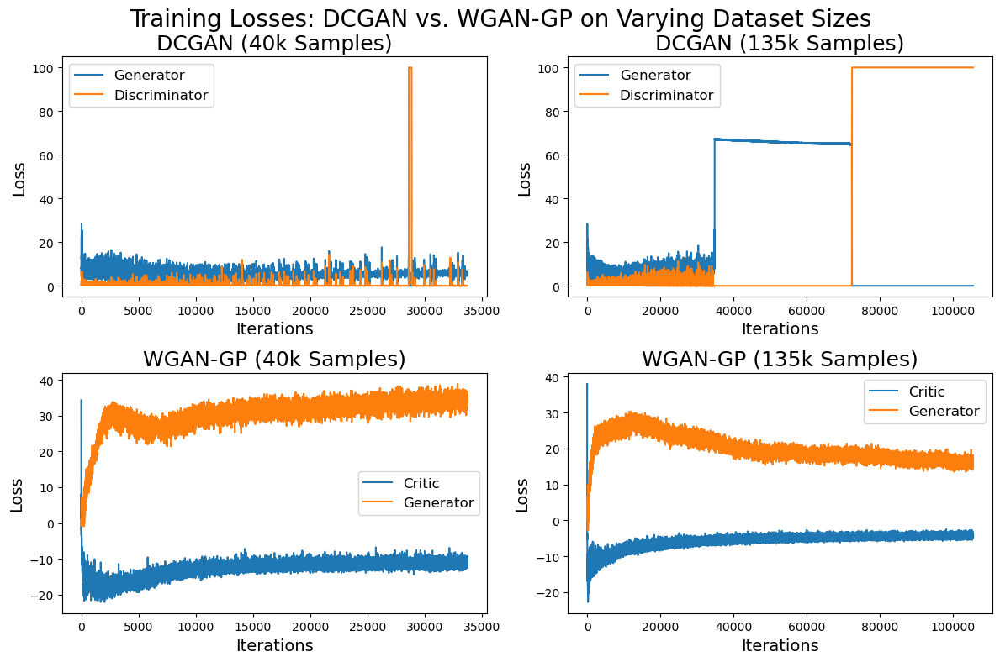

In [17]:
visualize_image_generator_training_losses()

# Experiment 2: Evaluation of ESRGAN Upscaling Models

In this experiment, we evaluate the performance of our trained ESRGAN-based super-resolution models on 64×64 anime images. We compare their effectiveness on two types of inputs:

- **Original 64×64 images** from the dataset
- **Enhanced-downscaled images**, created by upscaling the originals to 256×256 using Real-ESRGAN-Anime model and then downscaling back to 64×64


## Dataset Preparation

We define a custom dataset class that loads two corresponding sets of images:

- Original 64×64 anime faces
- Enhanced-downscaled 64×64 images (upscaled and then downscaled)


In [18]:
# === Step 1: Set Paths ===
lr_path = "sample_images/lr_images"
lr_plus_path = "sample_images/lr+_images"
dataset_length = 25


You can use the part below if the original and enhanced-downscaled images are not present in `sample_images/lr_images` and `sample_images/lr+_images`

In [19]:
os.makedirs(lr_path, exist_ok=True)
os.makedirs(lr_plus_path, exist_ok=True)

# Check if dataset has already been created
if not os.path.exists(lr_path) or not os.path.exists(lr_plus_path) or len(os.listdir(lr_path)) == 0 or len(os.listdir(lr_plus_path)) == 0:
    print("🚀 Creating dataset, as it's missing or incomplete...")

    # Create directories if they don't exist
    os.makedirs(lr_path, exist_ok=True)
    os.makedirs(lr_plus_path, exist_ok=True)
    
    # === Step 2: Get Device ===
    def get_device():
        if torch.cuda.is_available():
            return torch.device("cuda")
        elif torch.backends.mps.is_available():
            return torch.device("mps")
        else:
            return torch.device("cpu")
    
    device = get_device()
    
    # === Step 4: Load Kaggle Dataset ===
    dataset_name = "soumikrakshit/anime-faces"
    path = kagglehub.dataset_download(dataset_name)
    dataset = dset.ImageFolder(root=path, 
                              transform=transforms.Compose([
                                  transforms.Resize(64),
                                  transforms.CenterCrop(64),
                              ]))
    
    # === Step 5: Select 10,000 Random Images ===
    image_indices = np.random.choice(len(dataset), size=dataset_length, replace=False)


    lr_transform = transforms.Compose([
        transforms.Resize(64)])
    
    # === Step 6: Process and Save Images ===
    for i in tqdm(range(1, dataset_length+1), desc="Processing Images", unit="image"):
        idx = image_indices[i - 1]  # Ensure correct indexing
    
        # Load image
        lr_image = dataset[idx][0]  # Low-resolution (64x64)
        
        # Convert to tensor & send to device
        img_tensor = to_tensor(lr_image).unsqueeze(0).to(device)
    
        # Generate high-resolution image (256x256)
        with torch.no_grad():
            output_tensor = real_esrgan_anime_4x(img_tensor).clamp(0,1)
    
        # Convert to PIL image
        hr_image_256 = to_pil_image(output_tensor.squeeze(0))

    
        # Save images in ~/vision-project-images/
        lr_image.save(os.path.join(lr_path, f"{i}.png"))  # Save as 64x64
        lr_transform(hr_image_256).save(os.path.join(lr_plus_path, f"{i}.png")) # Save as 64x64 - ehanced downsclaled
    
    print(f"✅ Low-resolution images saved in: {lr_path}")
    print(f"✅ Enhanced-downscaled low-resolution images saved in: {lr_plus_path}")


else:
    print("✅ Dataset already exists. Skipping dataset creation.")


✅ Dataset already exists. Skipping dataset creation.


## Load Sample Images

We randomly select a batch of images from the dataset for evaluation and move them to the selected device (CPU, MPS, or GPU).

In [20]:
# Custom Dataset for Anime Faces
class AnimeFaceDataset(Dataset):
    def __init__(self, lr_folder, lr_plus_folder, lr_size=64):
        
        self.lr_images = sorted(glob.glob(os.path.join(lr_folder, "*.png")))
        self.lr_plus_images = sorted(glob.glob(os.path.join(lr_plus_folder, "*.png")))

        self.lr_transform = transforms.Compose([
        transforms.Resize(lr_size, interpolation=Image.BICUBIC),
        transforms.ToTensor()
    ])

    
    def __len__(self):
        return len(self.lr_images)
    
    def __getitem__(self, idx):
        lr_img = Image.open(self.lr_images[idx]).convert('RGB')
        lr_plus_img = Image.open(self.lr_plus_images[idx]).convert('RGB')

        # Create low-resolution version
        lr_img = self.lr_transform(lr_img)
        lr_plus_img = self.lr_transform(lr_plus_img)
        
        return lr_img, lr_plus_img

In [21]:
dataset = AnimeFaceDataset(lr_path, lr_plus_path, lr_size=64)
dataloader = DataLoader(dataset, batch_size=25, shuffle=False)

lr_images_sample, lr_plus_images_sample = next(iter(dataloader))
lr_images_sample = lr_images_sample.to(device)
lr_plus_images_sample = lr_plus_images_sample.to(device)

## Load Super-Resolution Models

We load four different ESRGAN-based super-resolution models:

- **ESRGAN\_V1 2×**: Trained on 64×64 → 128×128 using enhanced-downscaled images
- **ESRGAN\_V1 4×**: Trained on 64×64 → 256×256 using enhanced-downscaled images
- **ESRGAN\_V2 4×**: Trained on original 64×64 images to generate 256×256 outputs
- **Real-ESRGAN Anime 4×**: A pretrained model used as a high-quality baseline

Each model is loaded with its trained weights and set to evaluation mode. This setup allows for a fair visual comparison of model behavior on both real and synthetic inputs.


In [22]:
# Loaded above 

# checkpoint = torch.load(f'esrgan_imitation/models/final_generator_{2}x.pth', map_location=device)
# esrgan_v1_2x = ESRGANGenerator().to(device)
# esrgan_v1_2x.load_state_dict(checkpoint['generator_state_dict'])
# esrgan_v1_2x.eval()

# checkpoint = torch.load(f'esrgan_imitation/models/final_generator_{4}x.pth', map_location=device)
# esrgan_v1_4x = ESRGANGenerator(scale=4).to(device)
# esrgan_v1_4x.load_state_dict(checkpoint['generator_state_dict'])
# esrgan_v1_4x.eval()

# checkpoint = torch.load(f'esrgan_imitation2/models/final_generator_{4}x.pth', map_location=device)
# esrgan_v2_4x = ESRGANGenerator(scale=4).to(device)
# esrgan_v2_4x.load_state_dict(checkpoint['generator_state_dict'])
# esrgan_v2_4x.eval()

# checkpoint = torch.load(f'Real-ESRGAN/weights/RealESRGAN_x4plus_anime_6B.pth', map_location=device)
# real_esrgan_anime_4x = ESRGANGenerator(scale=4).to(device)
# if 'params_ema' in checkpoint:
#     real_esrgan_anime_4x.load_state_dict(checkpoint["params_ema"], strict=True)
# else:
#     real_esrgan_anime_4x.load_state_dict(checkpoint, strict=True)
# real_esrgan_anime_4x.eval()
# print("ESRGAN models are loaded")

## Super-Resolution Results

We apply the following models to both types of 64×64 inputs:

- ESRGAN\_V1 (2× and 4× upscaling)
- ESRGAN\_V2 (4× upscaling)
- Pretrained Real-ESRGAN Anime 4×

We visualize the results in a 5-row × 2-column grid:
- **Rows**: Input image and outputs from each model
- **Columns**: Original vs. enhanced-downscaled inputs

This side-by-side comparison highlights:
- ESRGAN\_V1 performs well on synthetic (downscaled) images but less so on original images.
- ESRGAN\_V2 generalizes better and provides consistent enhancements across both input types.


In [23]:
import matplotlib.pyplot as plt
import torchvision

def plot_sr_experiment(original, enhanced, save_path=None):
    original = original[:3].to(device)
    enhanced = enhanced[:3].to(device)

    # Run models
    with torch.no_grad():
        esrgan_v1_2x_original = torch.clamp(esrgan_v1_2x(original), 0, 1)
        esrgan_v1_2x_enhanced = torch.clamp(esrgan_v1_2x(enhanced), 0, 1)
        esrgan_v1_4x_original = torch.clamp(esrgan_v1_4x(original), 0, 1)
        esrgan_v1_4x_enhanced = torch.clamp(esrgan_v1_4x(enhanced), 0, 1)
        esrgan_v2_4x_original = torch.clamp(esrgan_v2_4x(original), 0, 1)
        esrgan_v2_4x_enhanced = torch.clamp(esrgan_v2_4x(enhanced), 0, 1)
        real_esrgan_anime_4x_original = torch.clamp(real_esrgan_anime_4x(original), 0, 1)
        real_esrgan_anime_4x_enhanced = torch.clamp(real_esrgan_anime_4x(enhanced), 0, 1)


    def to_grid_np(images):
        grid = torchvision.utils.make_grid(images.cpu(), nrow=3)
        return grid.numpy().transpose((1, 2, 0))

    grids = [
        to_grid_np(original),
        to_grid_np(enhanced),
        to_grid_np(esrgan_v1_2x_original),
        to_grid_np(esrgan_v1_2x_enhanced),
        to_grid_np(esrgan_v1_4x_original),
        to_grid_np(esrgan_v1_4x_enhanced),
        to_grid_np(esrgan_v2_4x_original),
        to_grid_np(esrgan_v2_4x_enhanced),
        to_grid_np(real_esrgan_anime_4x_original),
        to_grid_np(real_esrgan_anime_4x_enhanced),
    ]

    row_labels = ["Input", "ESRGAN_V1 2x", "ESRGAN_V1 4x", "ESRGAN_V2 4x", "Real-ESRGAN\nAnime"]
    
    col_titles = ["Original 64x64", "Enhanced-downscaled 64x64"]

    fig, axes = plt.subplots(5, 2, figsize=(9, 9))

    for i in range(5):  # rows
        for j in range(2):  # cols
            idx = i * 2 + j
            ax = axes[i, j]
            ax.imshow(grids[idx], interpolation='bicubic')

            if i == 0:
                ax.set_title(col_titles[j], fontsize=12)

    # Add row labels on the left side (simulated y-axis labels)
    for ax, row_label in zip(axes[:, 0], row_labels):
        ax.annotate(row_label, xy=(0, 0.5), xytext=(-ax.yaxis.labelpad - 30, 0),
                    xycoords='axes fraction', textcoords='offset points',
                    size='large', ha='right', va='center', rotation=90)

    title = "Super-Resolution Results for Original vs. Enhanced-Downscaled 64x64 Anime Images"

    # Add title temporarily, remove before saving
    fig.suptitle(title, fontsize=15)
    plt.tight_layout()
    
    if save_path:
        # Temporarily remove the title for saving
        fig.canvas.draw()  # Required to finalize the layout
        fig.suptitle("")   # Remove title
        plt.savefig(save_path, bbox_inches='tight', dpi=100)
        fig.suptitle(title, fontsize=15)  # Add title back for display

    
    plt.show()
    plt.close()

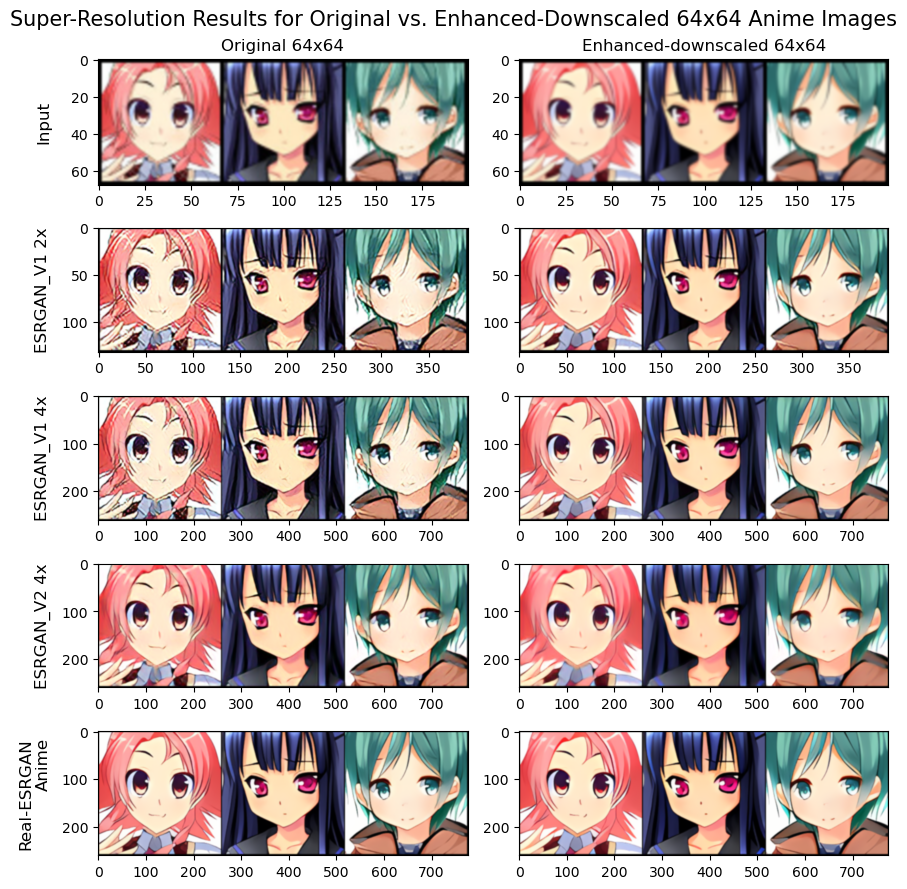

In [24]:
# Call plotting function
plot_sr_experiment(
    original=lr_images_sample,
    enhanced=lr_plus_images_sample,
    save_path = "experiment_images/sr-experiment-results.png"
)

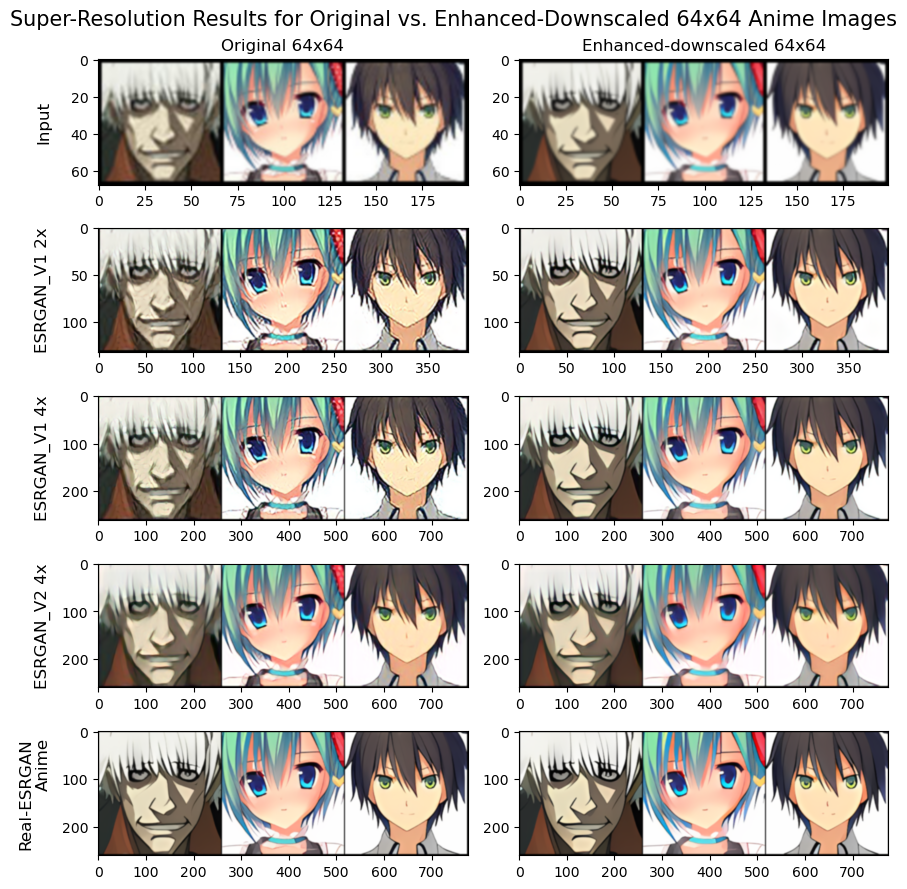

In [25]:
# Call plotting function
plot_sr_experiment(
    original=lr_images_sample[10:],
    enhanced=lr_plus_images_sample[10:],
)

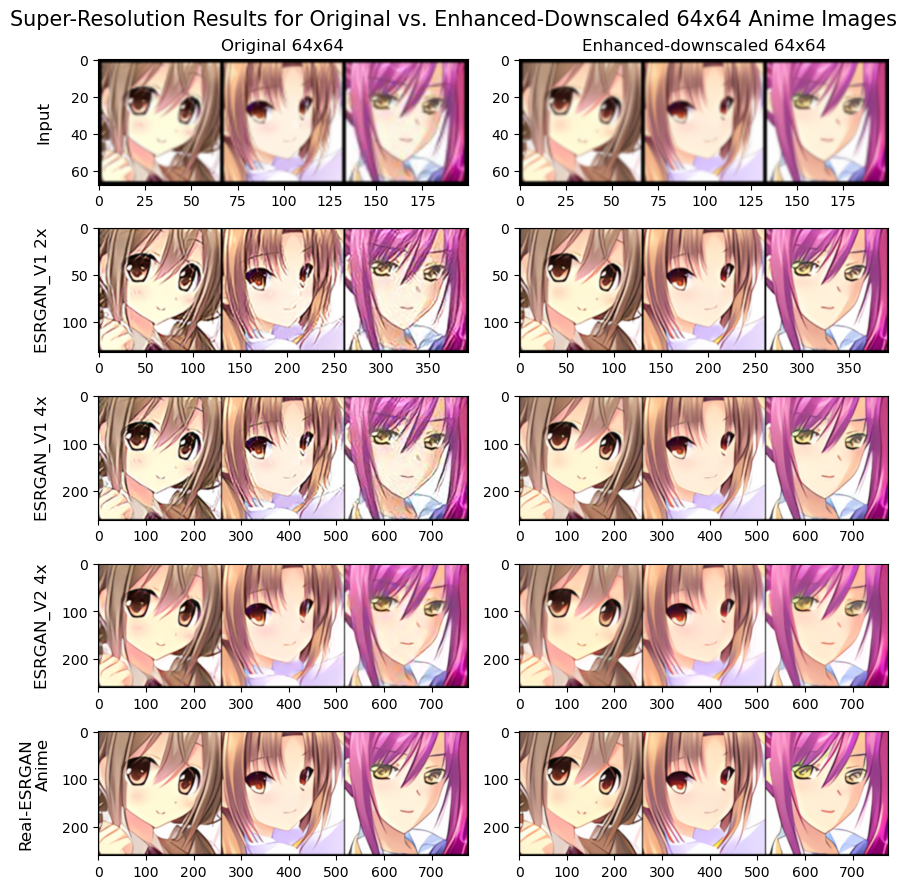

In [26]:
# Call plotting function
plot_sr_experiment(
    original=lr_images_sample[18:],
    enhanced=lr_plus_images_sample[18:],
)

# Ablation Study – Effect of Generator Architecture and Dataset Size

In this study, we analyze how different generator architectures (DCGAN vs. WGAN-GP) and dataset sizes (40k vs. 135k samples) impact the final image quality after applying super-resolution with our ESRGAN\_V2 4× model.

We selected the best-performing checkpoints for each model:
- **DCGAN-135k** (Epoch 30)
- **DCGAN-40k** (Epoch 100)
- **WGAN-GP-135k** (Epoch 100)
- **WGAN-GP-40k** (Epoch 100)

Using the same latent vectors (seed = 5042025), we generate batches of 64×64 images from each model and upscale them to 256×256 using ESRGAN\_V2.

The result is a side-by-side visual comparison, allowing us to:
- Observe qualitative differences between architectures
- Understand how dataset size influences detail and diversity
- Confirm whether ESRGAN\_V2 can consistently enhance outputs across varying generator quality

This visualization highlights that:
- **DCGAN-40k** produced the most consistent and appealing faces after upscaling
- **DCGAN-135k** suffered from training instability (mode collapse)
- **WGAN-GP** models were more stable overall, but output sharpness and structure varied slightly with dataset size

All images are arranged in a grid where each row corresponds to a model, and columns show individual upscaled samples.

The final plot is saved as: `experiment_images/anime_face_pipeline_outputs.png`


In [27]:
import torch
import matplotlib.pyplot as plt
import numpy as np
from torch.nn import functional as F
from matplotlib.gridspec import GridSpec


def plot_gan_comparison_with_esrgan(model_dataset_pairs, seed=1):
    """
    Plots generated images from different GAN models with bonded images and properly formatted labels.
    Ensures left-side labels are fully visible without truncation.
    
    Parameters:
    - model_dataset_pairs (list of tuples): List of (model_name, dataset_name, epoch) tuples
    - seed (int): Seed for latent vector generation
    """
    num_images = 8
    num_rows = len(model_dataset_pairs)
    
    # Increase left margin to prevent label truncation
    fig = plt.figure(figsize=(20, 10))
    
    # Create width ratios with wider space for labels
    width_ratios = [1.5] + [3] * num_images  # Increase label width
    
    # Use GridSpec with proper spacing
    gs = GridSpec(num_rows, num_images + 1, 
                 width_ratios=width_ratios,
                 wspace=0, hspace=0)  # Zero spacing between images
    
    # Generate fixed latents for consistency across models
    latents = get_fixed_latents(num_images, seed=seed)
    
    for row_idx, (img_generator, model_name, dataset_name, epoch) in enumerate(model_dataset_pairs):
        # Determine sample size string based on the dataset name
        sample_size = "135k" if dataset_name == dataset_name_135k else "40k"
        
        # Create left side label with model details
        label_ax = fig.add_subplot(gs[row_idx, 0])
        label_ax.axis('off')
        
        # Format label text
        if "dcgan" in model_name.lower():
            model_display = "DCGAN"
        elif "wgan-gp" in model_name.lower():
            model_display = "WGAN-GP"
        else:
            model_display = model_name.upper()
            
        model_label = f"{model_display}-{sample_size}\n(Epoch {epoch})"
        
        # Position text with enough padding to avoid truncation
        label_ax.text(0.3, 0.5, model_label, 
                     horizontalalignment='center',
                     verticalalignment='center',
                     fontsize=14, 
                     )
        
        img_generator.eval()
        
        # Generate images
        with torch.no_grad():
            # Generate images from the latent vectors
            fake_images = img_generator(latents)
            normalized_images = (fake_images + 1) / 2  # Scale from [-1,1] to [0,1]


            # Apply ESRGAN to the entire batch at once
            upscaled_batch = apply_esrgan(normalized_images)
            
            # Plot each upscaled image
            for img_idx in range(num_images):
                img_tensor = upscaled_batch[img_idx]
                img_np = img_tensor.permute(1, 2, 0).cpu().numpy()

                img_np = np.clip(img_np, 0, 1)  # Ensure values are in valid range
                
                # Add subplot for image
                img_ax = fig.add_subplot(gs[row_idx, img_idx + 1])
                img_ax.imshow(img_np)
                
                # Remove all axis elements completely
                img_ax.set_xticks([])
                img_ax.set_yticks([])
                img_ax.spines['top'].set_visible(False)
                img_ax.spines['right'].set_visible(False)
                img_ax.spines['bottom'].set_visible(False)
                img_ax.spines['left'].set_visible(False)
                img_ax.set_xmargin(0)
                img_ax.set_ymargin(0)
    




    # Adjust subplot spacing - increase left margin to prevent truncation
    plt.subplots_adjust(wspace=0, hspace=0, left=0.07, right=0.99, top=0.95, bottom=0.01)

    # Save or display the figure
    plt.savefig('experiment_images/anime_face_pipeline_outputs.png', bbox_inches='tight', pad_inches=0.2, dpi=100)

    # Add a main title
    plt.suptitle("Final Outputs of DCGAN and WGAN-GP Trained on 40k and 135k Datasets with ESRGAN_V2 4× Super-Resolution", fontsize=18, y=0.98)

    plt.show()
    
    
def apply_esrgan(img_tensor):
    """
    Apply ESRGAN_V2 4x upscaling to an image tensor
    
    Parameters:
    - img_tensor: Normalized tensor image [B, C, H, W] in range [0, 1]
    
    Returns:
    - Upscaled tensor image
    """
    # Ensure ESRGAN model is loaded and in evaluation mode
    esrgan_v2_4x.eval()
    
    with torch.no_grad():
        # ESRGAN models typically expect input in range [0, 1]
        upscaled = esrgan_v2_4x(img_tensor)
        
    return upscaled.clamp(0, 1)

In [28]:
model_dataset_pairs = [
    (dcgan_generator_135k, "dcgan", dataset_name_135k, 30),     # DCGAN-135k (Epoch 30)
    (dcgan_generator_40k, "dcgan", dataset_name_40k, 100),      # DCGAN-40k
    (wgan_gp_generator_135k, "wgan-gp", dataset_name_135k, 100),   # WGAN-GP-135k
    (wgan_gp_generator_40k, "wgan-gp", dataset_name_40k, 100)     # WGAN-GP-40k
]

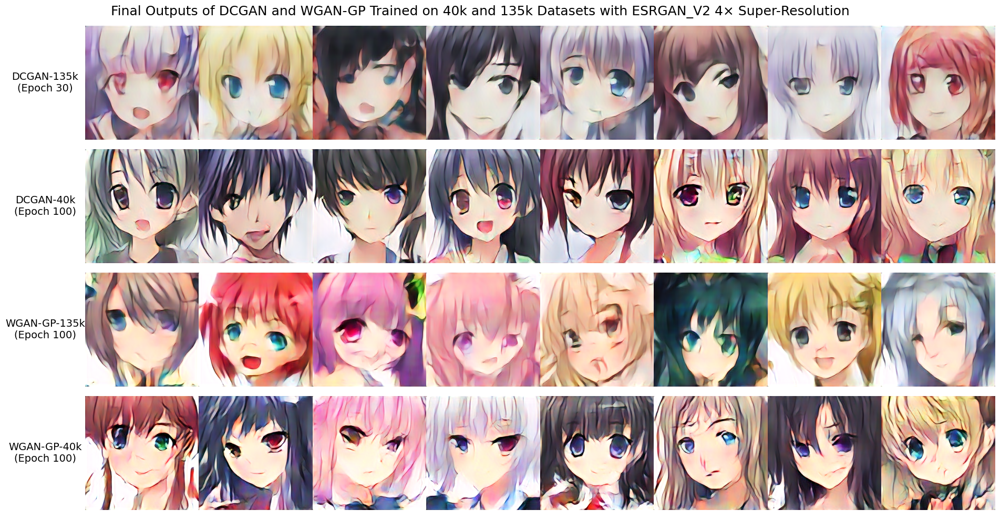

In [29]:
plot_gan_comparison_with_esrgan(model_dataset_pairs, seed=5042025) # 05.04.2025

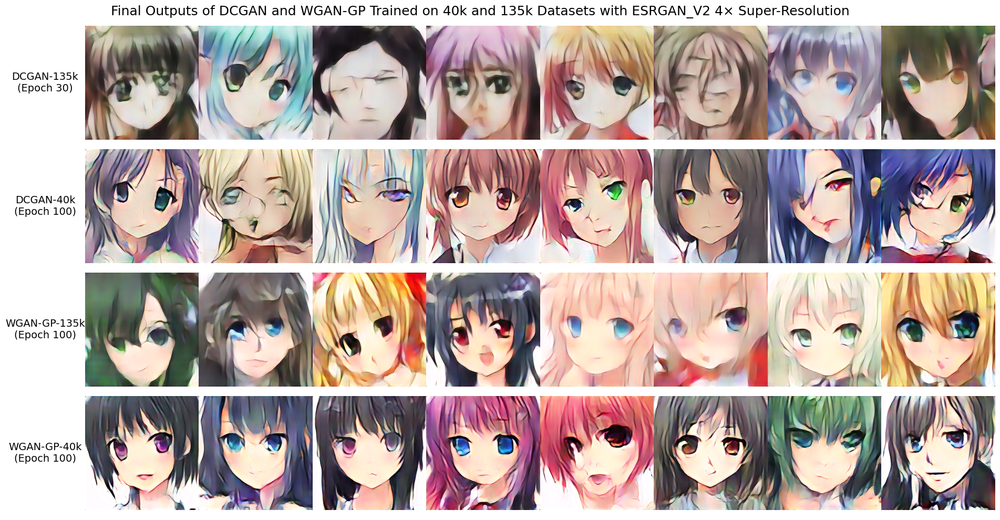

In [30]:
plot_gan_comparison_with_esrgan(model_dataset_pairs, seed=6042025) # 06.04.2025

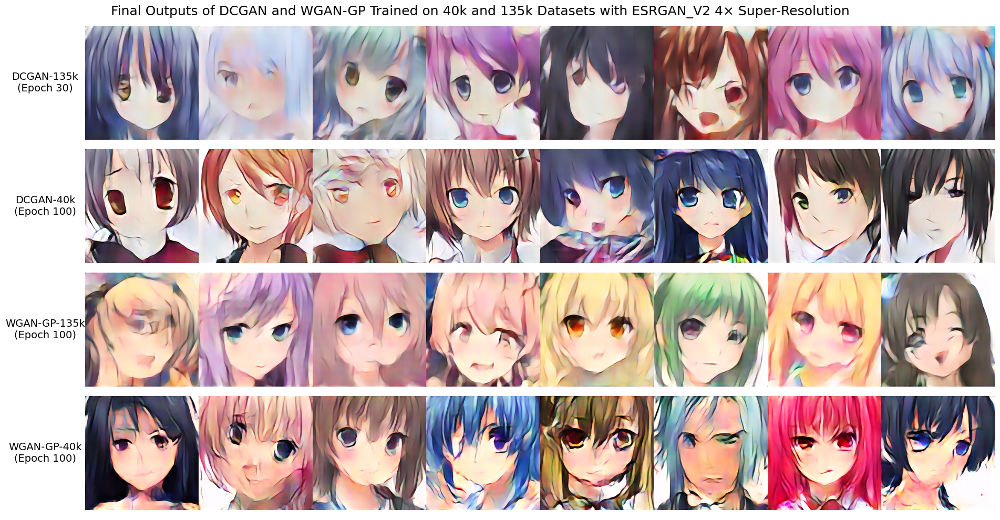

In [31]:
plot_gan_comparison_with_esrgan(model_dataset_pairs, seed=100)

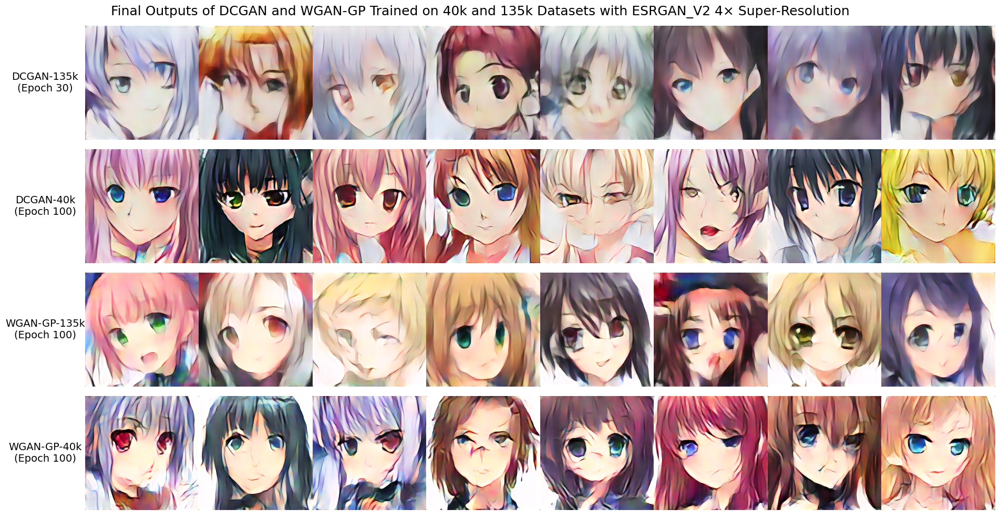

In [32]:
plot_gan_comparison_with_esrgan(model_dataset_pairs, seed=6)

# Ablation Study – Effect of Super-Resolution Enhancement

To isolate the impact of the super-resolution stage in our pipeline, we perform a direct visual comparison of generated images **with and without** the ESRGAN\_V2 4× enhancement.

We use the **DCGAN-40k** model, which showed the best image quality among the generators. We generate 3 images at 64×64 resolution. These are shown side by side with their corresponding 256×256 super-resolved outputs from


In [33]:
def plot_dcgan_vs_esrgan_row(seed, generator_model=dcgan_generator_40k, esrgan_model=esrgan_v2_4x, device=device, to_np_image=None, save_path=None):
    """
    Creates a 1-row image grid: 3 DCGAN-40k outputs and their ESRGAN_V2 4x results,
    with clear borders and labels using torchvision's make_grid and matplotlib annotations.
    """

    # Generate fixed latent vectors
    latents = get_fixed_latents(3, seed=seed).to(device)

    generator_model.eval()
    esrgan_model.eval()

    with torch.no_grad():
        # Generate low-res images
        low_res = generator_model(latents)
        low_res = (low_res + 1) / 2  # normalize to [0, 1]

        # Upscale using ESRGAN
        high_res = esrgan_model(low_res).clamp(0, 1)

    # Use torchvision to make image grids
    grid_low = torchvision.utils.make_grid(low_res, nrow=3, padding=2)
    grid_high = torchvision.utils.make_grid(high_res, nrow=3, padding=2)

    grids = [grid_low.cpu().numpy().transpose(1, 2, 0),
             grid_high.cpu().numpy().transpose(1, 2, 0)]

    col_titles = ["with ESRGAN_V2", "without ESRGAN_V2"]
    
    fig, axes = plt.subplots(1, 2, figsize=(12, 3.))

    for i in range(2):
        ax = axes[i]
        ax.imshow(grids[i])
        ax.axis('off')

        # Add row label on left side
        ax.set_title(col_titles[i], fontsize=11)

        # Add y-axis label (only once, on left)
    axes[0].annotate("DCGAN-40k", xy=(0, 0.5), xytext=(-axes[0].yaxis.labelpad - 10, 0),
                     xycoords='axes fraction', textcoords='offset points',
                     fontsize=12, ha='right', va='center', rotation=90)



    plt.tight_layout()
    fig.suptitle("Comparison of DCGAN-40k Outputs With and Without ESRGAN_V2 4×", fontsize=15)
    
    if save_path:
        plt.savefig(save_path, bbox_inches='tight', pad_inches=0.2, dpi=100)

    
    plt.show()
    plt.close()

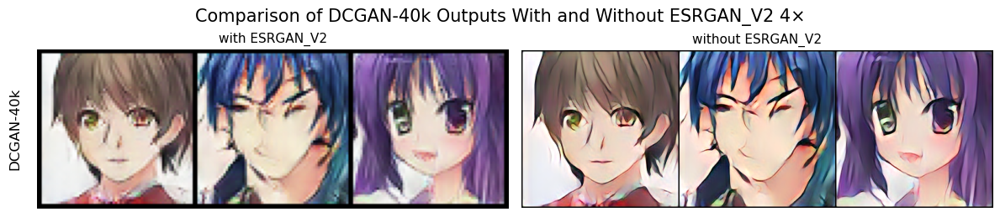

In [34]:
plot_dcgan_vs_esrgan_row(
    seed=5,
)

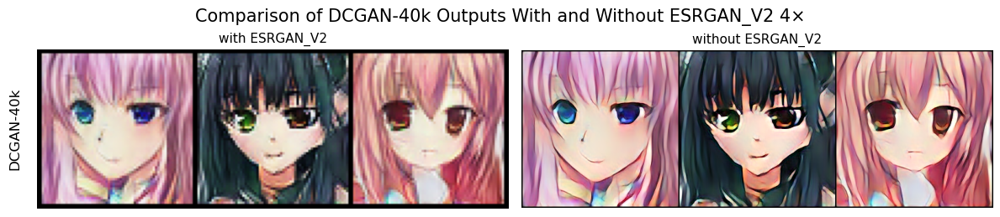

In [35]:
plot_dcgan_vs_esrgan_row(
    seed=6,
)

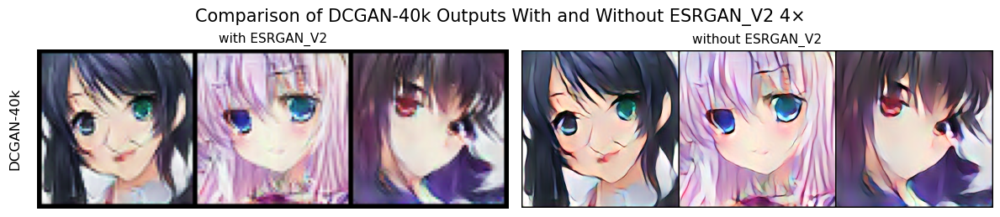

In [36]:
plot_dcgan_vs_esrgan_row(
    seed=42,
)

# Comparative Enhancement Study – Evaluating Different Super-Resolution Models

In this experiment, we explore how different super-resolution models affect the final image quality of generated anime faces. Given a fixed set of latent vectors, we use each generator model to synthesize low-resolution (64×64) images, and then apply three different super-resolution methods:

- **Real-ESRGAN Anime 4×** – A high-quality pretrained baseline
- **ESRGAN\_V1 4×** – Trained on downscaled synthetic data
- **ESRGAN\_V2 4×** – Trained on original 64×64 dataset images

We perform this comparison for the best checkpoint of each generator:
- DCGAN-40k (Epoch 100)
- DCGAN-135k (Epoch 30)
- WGAN-GP-40k (Epoch 100)
- WGAN-GP-135k (Epoch 100)

The goal is to assess:
- Visual consistency and enhancement quality across different upscaling models
- Whether ESRGAN\_V2 can match or outperform Real-ESRGAN
- How super-resolution interacts with underlying generator quality

Each subplot shows:
1. Original generated 64×64 images  
2. Output enhanced by Real-ESRGAN Anime 4×  
3. Output enhanced by ESRGAN\_V1 4×  
4. Output enhanced by ESRGAN\_V2 4×

This allows us to evaluate perceptual differences side by side and validate the robustness and effectiveness of our custom-trained models.


In [37]:
def generate_and_plot_enhanced_images(generator_model, title, latents):
    """
    Generates images using the given generator model and applies three enhancement models.
    Displays a 2x2 subplot of original and enhanced images.

    Parameters:
    - generator_model (torch.nn.Module): The image generator (e.g., DCGAN).
    - title (str): Main title for the entire plot.
    - latents (torch.Tensor): Latent vectors for the generator.
    - esrgan_2x (torch.nn.Module): 2x enhancement model.
    - esrgan_4x (torch.nn.Module): 4x enhancement model.
    - real_esrgan_anime_4x (torch.nn.Module): Pretrained Real-ESRGAN Anime model.
    """
    generator_model.eval()

    latents = latents[:3]
    with torch.no_grad():
        fake_images = generator_model(latents)
        
 
        
        normalized_images = (fake_images + 1) / 2  # Scale from [-1, 1] to [0, 1]

        
        clamped_images = torch.clamp(normalized_images, 0, 1)

        enhanced_v1_4x = torch.clamp(esrgan_v1_2x(clamped_images), 0, 1)
        enhanced_v2_4x = torch.clamp(esrgan_v2_4x(clamped_images), 0, 1)
        enhanced_real_esrgan = torch.clamp(real_esrgan_anime_4x(clamped_images), 0, 1)

    original_img = to_grid_np(normalized_images)
    enhanced_img_v1_4x = to_grid_np(enhanced_v1_4x)
    enhanced_img_v2_4x = to_grid_np(enhanced_v2_4x)
    enhanced_img_real = to_grid_np(enhanced_real_esrgan)

    # Plot images
    fig, axs = plt.subplots(2, 2, figsize=(12, 4.5))
    axs[0, 0].imshow(original_img)
    axs[0, 0].set_title("Original Generated Images")

    axs[0, 1].imshow(enhanced_img_real)
    axs[0, 1].set_title("Enhanced with Real-ESRGAN Anime (4x)")

    axs[1, 0].imshow(enhanced_img_v1_4x)
    axs[1, 0].set_title("Enhanced with ESRGAN_V1 4x")

    axs[1, 1].imshow(enhanced_img_v2_4x)
    axs[1, 1].set_title("Enhanced with ESRGAN_V2 4x")

    for ax in axs.flat:
        ax.axis("off")

    plt.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.show()

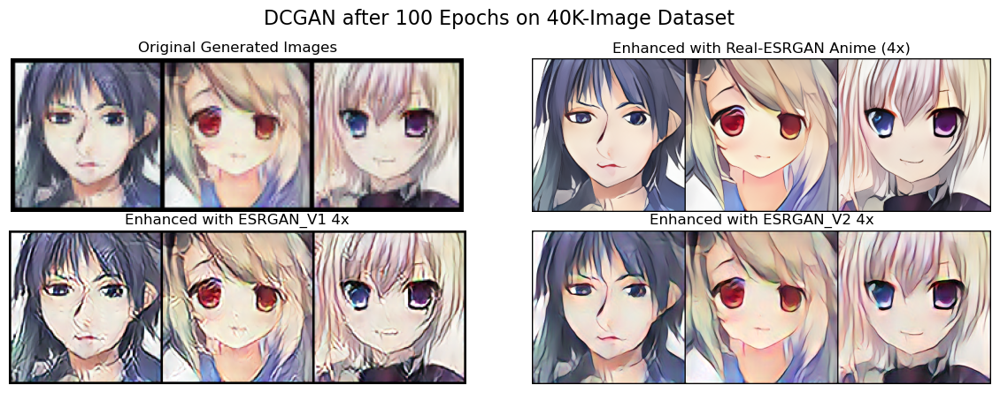

In [38]:
generate_and_plot_enhanced_images(
    generator_model=dcgan_generator_40k,
    title="DCGAN after 100 Epochs on 40K-Image Dataset",
    latents=latents,
)

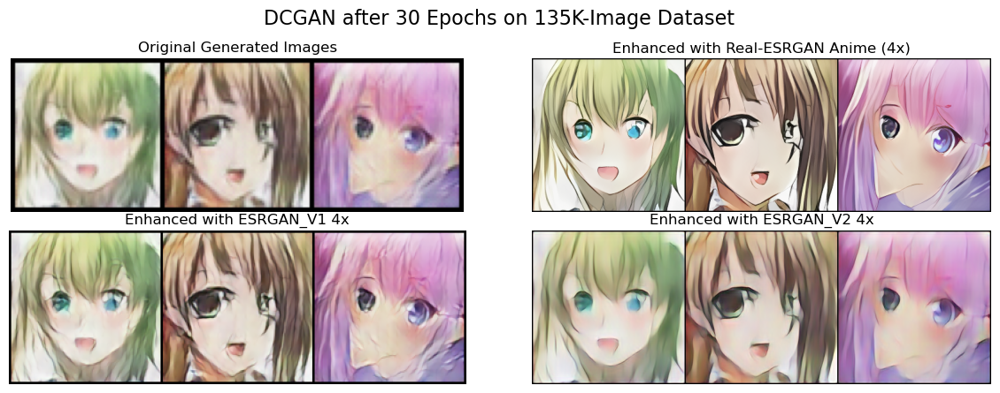

In [39]:
generate_and_plot_enhanced_images(
    generator_model=dcgan_generator_135k,
    title="DCGAN after 30 Epochs on 135K-Image Dataset",
    latents=latents,
)

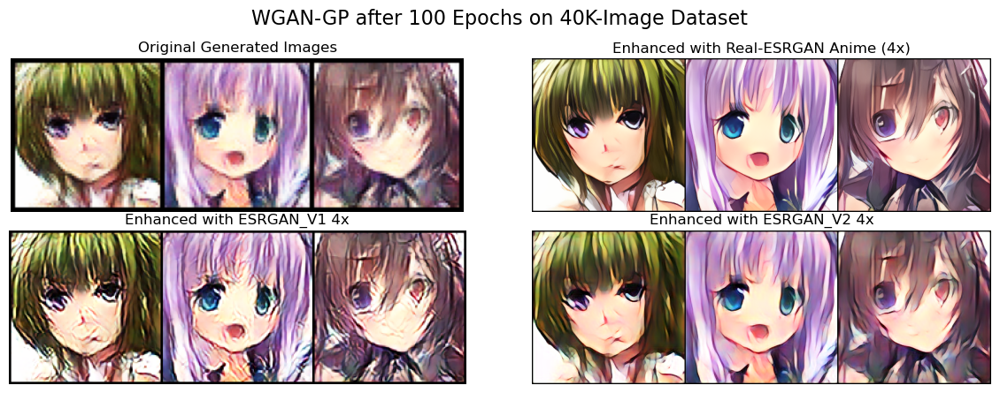

In [40]:
generate_and_plot_enhanced_images(
    generator_model=wgan_gp_generator_40k,
    title="WGAN-GP after 100 Epochs on 40K-Image Dataset",
    latents=latents,
)

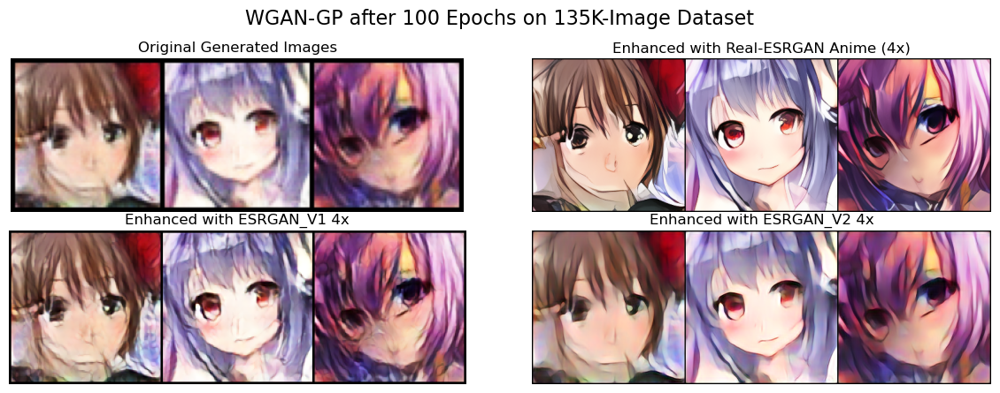

In [41]:
generate_and_plot_enhanced_images(
    generator_model=wgan_gp_generator_135k,
    title="WGAN-GP after 100 Epochs on 135K-Image Dataset",
    latents=latents,
)